In [1]:
%pip install sympy --upgrade

Defaulting to user installation because normal site-packages is not writeable
Looking in indexes: https://pypi.org/simple, https://pypi.ngc.nvidia.com
Note: you may need to restart the kernel to use updated packages.


In [2]:
import sympy as sp
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import math
from IPython.display import HTML,display

# Ecuacion parabolica de un acuifero 

## Condiciones de contorno tipo Dirichlet:
La ecuacion es:
 ## <center>$\frac{\partial h}{\partial t}=\alpha^2\frac{\partial^{2} h}{\partial x^{2}}$ 
    
con las siguientes condiciones:   
<center>$h(x,0)=f(x)$   
<center>$h(0,t)=h(L,t)=0$
    
    
La solucion analitica general de esta ecuación esta dada por la siguiente, formula:     
###  <center>$h(x,t)=\sum_{n=1}^{\infty}b_{n}sin(\frac{n\pi}{L}x)e^{\frac{-\alpha^2n^2\pi^2}{L^2}t}$  
Con    
###   <center>$b_{n}=\frac{2}{L} \int_{x=0}^{x=L} f(x)sin(\frac{n\pi}{L}x)dx$    
 

Teniendo en cuenta que la ecuacion solucionada tiene la forma:
    
## <center>$\frac{\partial h}{\partial t}=\alpha^2\frac{\partial^{2} h}{\partial x^{2}}$ 
    
    
Y la ecuación a resolver es:
    
## <center>$\frac{\partial h}{\partial t}=\frac{T}{S}\frac{\partial^{2} h}{\partial x^{2}}$ 

Se tiene que
    
## <center>$\alpha=\sqrt{\frac{T}{S}}$    
    

    
    
    
Si tomamos 
###<center>$f(x)=-sin(\frac{xm\pi}{L})$ con $m\in \mathbb N$
    
    
    
se tiene que,  $b_{n}=$    


In [3]:
#calculemos la integral con sympy
x,n,L,pi,m,alfa,t,e=sp.symbols("x n L pi m alfa t e")
b_n=-2/L*sp.simplify(sp.integrate(sp.sin(n*pi*x/L)*sp.sin(m*pi*x/L),(x,0,L)))
print("La integral tiene el valor")
b_n



La integral tiene el valor


-2*Piecewise((0, Eq(pi, 0)), (-L/2 + L*sin(2*n*pi)/(4*n*pi), Eq(m, -n) | (Eq(m, 0) & Eq(n, 0))), (L/2 - L*sin(2*n*pi)/(4*n*pi), Eq(m, n) | (Eq(m, 0) & Eq(n, 0))), (L*(-m*sin(n*pi)*cos(m*pi) + n*sin(m*pi)*cos(n*pi))/(pi*(m**2 - n**2)), True))/L

Por tanto, cuando m=n la solucion de la ecuacion es:



    
### <center>$b_n=-\frac{1}{2}(2+\frac{sin(2n\pi)}{n\pi})$

Ya que cuando $m\neq n$, se hace cero el termino ya que seno de un multiplo de $\pi$ es cero.
             

como $n\in \mathbb N $ entonces seno vale cero y se tiene que:
   <center>$b_n=-1$
    
<center>$h(x,t)=-sin(\frac{n\pi}{L}x)e^{\frac{-\alpha^2n^2\pi^2}{L^2}t}$      

    




Ya teniendo la solución ya podemos contruir uan funcion en numpy y asignar valores a las variables L,m y alfa,$\pi$, para evaluar y graficar

In [4]:
L1=200
m1=1
pi1=np.pi

T=900
S=100
alfa1=math.sqrt(T/S)

tiempo=1200
def solucion_analitica1(x,t):
              
    sol=-np.sin(m1*np.pi*x/L1)*np.exp(-alfa1**2*m1**2*np.pi**2*t/L1**2)   
    return sol    

Grafico de la solución analitica 

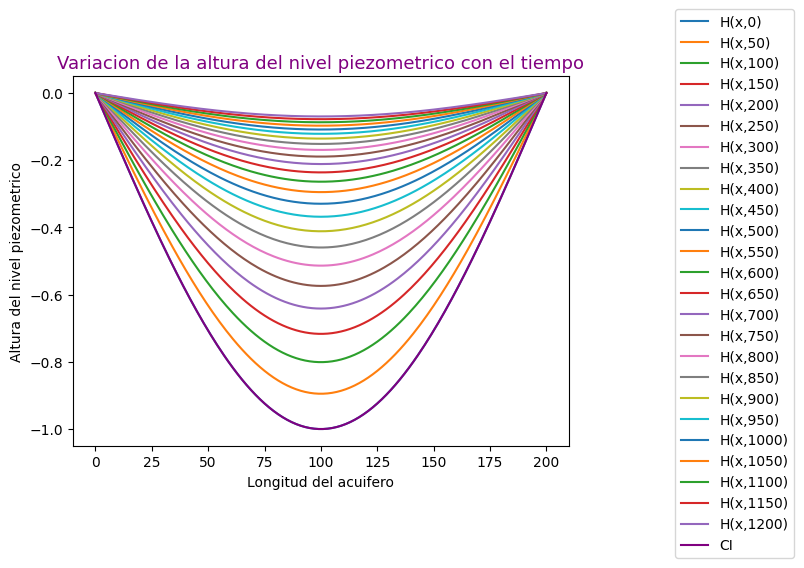

In [5]:
%matplotlib inline
x_analit=np.arange(L1+1)
for t in range(0,tiempo+1,50):
    y=solucion_analitica1(x_analit,t)
    plt.plot(x_analit,y,label=f"H(x,{t})")

plt.title("Variacion de la altura del nivel piezometrico con el tiempo",
          fontdict={"color":"purple","fontsize":"13"})
plt.plot(x_analit,-np.sin(x_analit*np.pi*m1/L1),label="CI",color="purple")
plt.xlabel("Longitud del acuifero")
plt.ylabel("Altura del nivel piezometrico")
plt.legend( bbox_to_anchor=(1.2,1.2))
plt.show()

Simulación de la solucion analitica

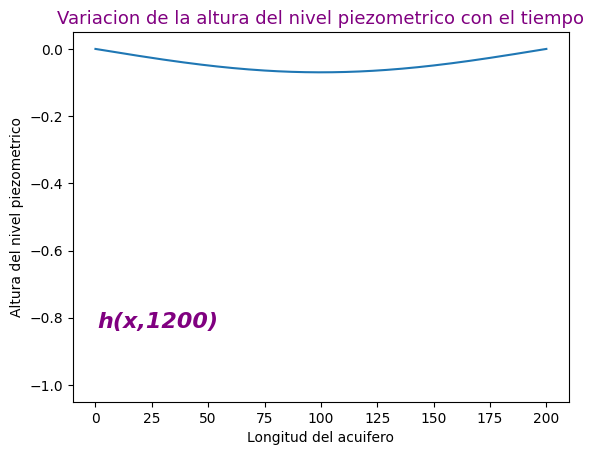

In [6]:
#para correrlo local     %matplotlib notebook  abajo

#%matplotlib notebook 
fig, ax=plt.subplots()
container = []

ht=5
plt.title("Variacion de la altura del nivel piezometrico con el tiempo"
          ,fontdict={"color":"purple","fontsize":"13"})
plt.xlabel("Longitud del acuifero")
plt.ylabel("Altura del nivel piezometrico")
for i in range(0,tiempo+ht,ht):
    line, = ax.plot(solucion_analitica1(x_analit,i), animated=True,label="jaja")
    
    
    
    title = ax.text(0.05,0.2,f"h(x,{i})",
                    transform=ax.transAxes, fontdict={'size': 16,
                        "color":"purple","fontweight":"bold"
                        ,"fontstyle":'italic'})
    
    container.append([line,title])

animacion_analitica1 = animation.ArtistAnimation(fig, container, interval=10, blit=True)


HTML(animacion_analitica1.to_jshtml())




## Metodo de diferencias finitas
Recordemos la ecuacion:

## <center>$\frac{\partial h}{\partial t}=\alpha^2\frac{\partial^{2} h}{\partial x^{2}}$ 
    
con las siguientes condiciones:   
<center>$h(x,0)=f(x)$   
<center>$h(0,t)=h(L,t)=0$
    
la discretizacion de segundo orden en el espacio y primer orden en el tiempo esta dada por:    
    
    
## <center>$\frac{h^{n+1}_i-h^{n}_i}{dt}=\alpha^2
\frac{h^{n}_{i}-2h^{n}_{i}+h^{n}_{i+1}}{dx}$
    
donde $dt$ y $dx$ son los pasos en el tiempo y x respectivamente.  
despejando se tiene:
    
### <center>$h^{n+1}_{i}=(1-2r)h^{n}_{i}+r(h^{n}_{i-1}+h^{n}_{i+1})$

de las condiciones de contorno se tiene que:
    
### <center>$h^{n}_{i=0}=h^{n}_{i=L}=0$
    
y de la condición inicial: 

### <center>$h^{0}_{i}=f(i)$

    
con 
    
###   <center>$r=\frac{\alpha^2dt}{dx}$   
### <center>$\alpha=\sqrt{\frac{T}{S}}$    

Para que sea estable la solución se debe cumplir la siguiente condición:
<center>$0\leq r \leq\frac{1}{2}$
    
por tanto la relacion entre los pasos debe cumplir:
    
### <center>$dt \leq\frac{dx^2}{2\alpha^2}$

Ahora implementemos la solucion en diferencias:

In [7]:
#recuerde colocar los mismo valores 
#para comparar con la solución analitica
L1=200
m1=1
pi1=np.pi
T=900
S=100
alfa1=math.sqrt(T/S)

dx=5
dt=1
estabilidad=(dt<=(dx**2/(2*alfa1**2)))
tiempo=1200
r=alfa1**2*dt/dx**2

print("La solución es estable:", estabilidad)

x_DF=np.arange(0,L1+dx,dx) #particion de la longitud del acuifero
N=len(x_DF)

#condicion inicial

h0=-np.sin(x_DF*np.pi/L1)

h1=np.zeros(N)
#condciones de contorno

h1[N-1]=0
h1[0]=0

La solución es estable: True


Codigo en diferencias finitas para encontar la solucion e un tiempo n.

In [8]:
h0=-np.sin(x_DF*np.pi/L1)
h1=np.zeros(N)

solucion_diferencias_finitas1=[h0]
t=dt
while t<=tiempo:

    h1=(1-2*r)*h0+r*(np.roll(h0,1)+np.roll(h0,-1))
    h1[N-1]=0
    h1[0]=0
    solucion_diferencias_finitas1.append(h1)
    h0=h1
    t+=dt
    

Grafico de la solucion en diferencias finitas

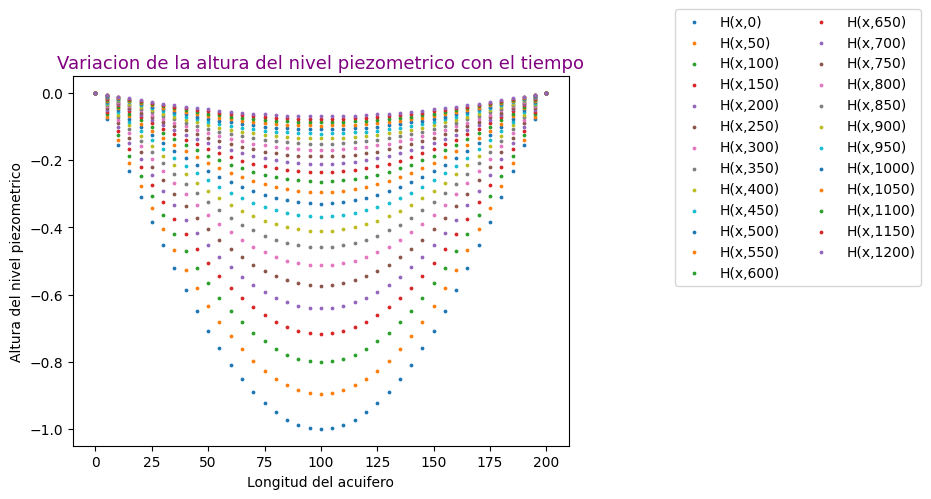

In [9]:
%matplotlib inline
for t in range(0,tiempo+1,50):
    
    plt.scatter(x_DF,solucion_diferencias_finitas1[t]
                ,label=f"H(x,{t})",s=3)

plt.title("Variacion de la altura del nivel piezometrico con el tiempo",fontdict={"color":"purple","fontsize":"13"})
#plt.plot(x_DF,-np.sin(x_DF*np.pi*m1/L1),label="CI",color="purple")
plt.xlabel("Longitud del acuifero")
plt.ylabel("Altura del nivel piezometrico")
plt.legend( bbox_to_anchor=(1.2,1.2),ncol=2)
plt.show()

Simulacion en de la solución en diferencias finitas 

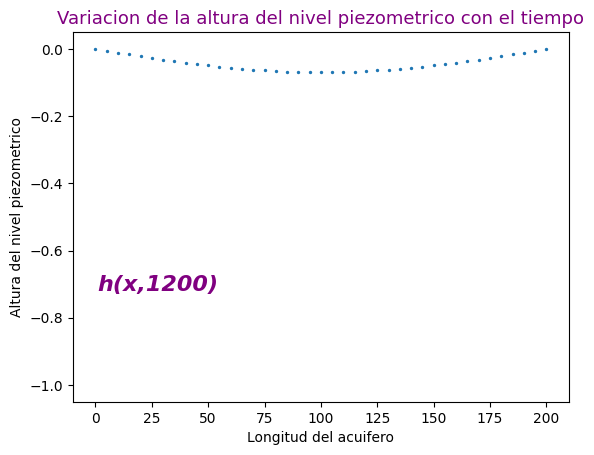

In [10]:
#para correrlo local     %matplotlib notebook  abajo descomentar
#%matplotlib notebook 

fig, ax=plt.subplots()
container = []

ht=5
plt.title("Variacion de la altura del nivel piezometrico con el tiempo"
          ,fontdict={"color":"purple","fontsize":"13"})
plt.xlabel("Longitud del acuifero")
plt.ylabel("Altura del nivel piezometrico")
for i in range(0,tiempo+ht,ht):
    scat = ax.scatter(x_DF,solucion_diferencias_finitas1[i],
                      s=2 ,animated=True)
    
    title = ax.text(0.05,0.3,f"h(x,{i})",
                   transform=ax.transAxes,fontdict={'size': 16,
                        "color":"purple","fontweight":"bold"
                        ,"fontstyle":'italic'} )
    
    container.append([scat,title])

animacion_dif_finitas1 = animation.ArtistAnimation(fig, container, interval=20, blit=True)



HTML(animacion_dif_finitas1.to_jshtml())

### Comparación de las soluciones  
Grafico de la superposición de las soluciones


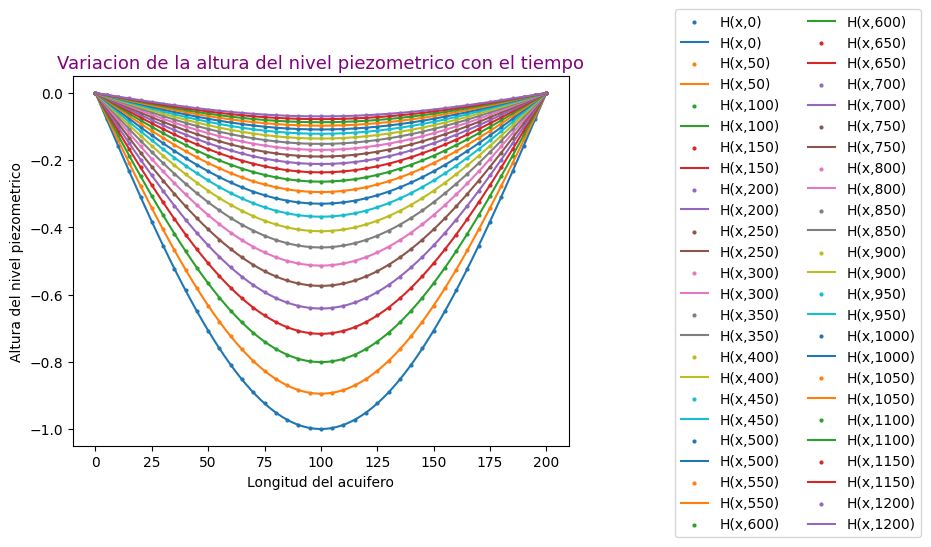

In [11]:
%matplotlib inline
xt=np.arange(L1+1)
ht=50
for t in range(0,tiempo+1,ht):
    y=solucion_analitica1(x_analit,t)
    plt.scatter(x_DF,solucion_diferencias_finitas1[t],
                label=f"H(x,{t})",s=4)
    plt.plot(xt,y,label=f"H(x,{t})")

    plt.title("Variacion de la altura del nivel piezometrico con el tiempo",fontdict={"color":"purple","fontsize":"13"})
#plt.plot(xt,-np.sin(x_analit*np.pi*m1/L1),label="CI",color="purple")
plt.xlabel("Longitud del acuifero")
plt.ylabel("Altura del nivel piezometrico")
plt.legend( bbox_to_anchor=(1.2,1.2),ncol=2)
plt.show()

Simulación de la superposición de las soluciones 

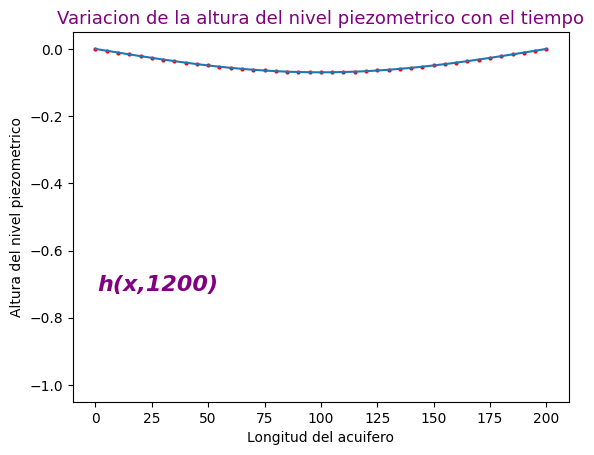

In [12]:
#para correrlo local     %matplotlib notebook  abajo descomentar
#%matplotlib notebook 

fig, ax=plt.subplots()
container = []
ht=5

plt.title("Variacion de la altura del nivel piezometrico con el tiempo"
          ,fontdict={"color":"purple","fontsize":"13"})
plt.xlabel("Longitud del acuifero")
plt.ylabel("Altura del nivel piezometrico")
for i in range(0,tiempo+ht,ht):
    line, = ax.plot(solucion_analitica1(x_analit,i), animated=True,label="jaja")
    
    scat = ax.scatter(x_DF,solucion_diferencias_finitas1[i],s=4 ,color="red",animated=True)
    
    title = ax.text(0.05,0.3,f"h(x,{i})",
                    transform=ax.transAxes,fontdict={'size': 16,
                        "color":"purple","fontweight":"bold"
                        ,"fontstyle":'italic'} )
    
    container.append([line,title,scat])

animacion_superposicion= animation.ArtistAnimation(fig, container, interval=10, blit=True)

HTML(animacion_superposicion.to_jshtml())

## Condiciones de contorno mixtas
La ecuacion es:
 ## <center>$\frac{\partial h}{\partial t}=\alpha^2\frac{\partial^{2} h}{\partial x^{2}}$ 
    
con las siguientes condiciones:   
### <center>$h(x,0)=f(x)$   
### <center>$h(L,t)=h_{x}(0,t)=0$
    
La solución en variables separables de la ecuacion anterior es:
    
#### <center>$X^{\prime\prime}(x)+\lambda X (x)=0$       
#### <center>$T^{\prime}(t)+\alpha^2\lambda T(t)=0$  
    
Las ecuaciones ordinarias anteriores tienen coo solución:
    
#### <center>$X(x)=Acos(\lambda x)+Bsin(\lambda x)$
#### <center>$T(t)=Ce^{-\alpha^2 \lambda ^ 2t}$  
    
para hallar las contantes, se utilizan las condiciones de contorno e iniciales, usamos la dos de contorno para hallar $A$ y $B$.  
    
#### <center>$X^{\prime}(x)=A\lambda cos(\lambda 0)+B\lambda sin(\lambda 0)=0$
#### <center>$X(L)=Acos(\lambda L)+Bsin(\lambda L)=0$   
    
por tanto, $B$ reemplezando en la segundo se tiene que:   
    
#### <center>$X(L)=Acos(\lambda L)=0$   
    
entonces:
    
### <center>$\lambda=\frac{\pi}{2L}(2n-1)$ 
    
con $n\in \mathbb N$
    
Por tanto, la solución tiene la siguiente forma:

###  <center>$h(x,t)=\sum_{n=1}^{\infty}A_{n}cos(\frac{\pi}{2L}(2n-1)x)e^{\frac{-\alpha^2(2n-1)^2\pi^2}{4L^2}t}$  

para hallar el valor de  $A_{n}$ hacemos uso la condicion inicial y de la ortogonalidad de las funciones coseno en dicho intervalo.
    
    
###  <center>$h(x,0)=\sum_{n=1}^{\infty}A_{n}cos(\frac{\pi}{2L}(2n-1)x)=f(x)$  
    
multiplicando a ambos lados de la ecuacion por $cos(\frac{\pi}{2L}(2m-1)x)$ con $m\in \mathbb N$ se obtiene: 

###   <center>$\int_{x=0}^{x=L}f(x)cos(\frac{(2n-1)\pi}{2L}x)dx=\frac{L}{2}\sum_{n=1}^{\infty}A_{n}\delta_{m,n}$   
    
despejando $A_{n}$ se tiene:
    
###   <center>$A_{n}=\frac{2}{L}\int_{x=0}^{x=L}f(x)cos(\frac{(2n-1)\pi}{2L}x)dx$
    
    
si tomamos 
    
###   <center>$f(x)=h0*cos(\frac{(2m-1)\pi}{2L}x)$ 
    
con m=1 y $h0$ que es el espesor maximo inicial de mi acuifero
    
calculemos $A_{n}$ con sympy:
    


haciendo la integral en python con m=n=1 debido a la ortogonalidad se tiene:

In [13]:
#calculemos la integral con sympy
x,n,L,pi,m,alfa,t,e=sp.symbols("x n L pi m alfa t e")
b_n=2/L*sp.simplify(sp.integrate(sp.cos(pi*x/(2*L))*sp.cos(pi*x/(2*L)),(x,0,L)))
print("La integral tiene el valor")
b_n

La integral tiene el valor


2*Piecewise((L*(pi + sin(pi))/(2*pi), Ne(pi/L, 0)), (L, True))/L

entonces ya que $sin(\pi)=0$ se tiene que:

### <center>$A_{n}=1$

Entonces la solución toma la forma final:
    
##  <center>$h(x,t)=cos(\frac{\pi}{2L}(2n-1)x)e^{\frac{-\alpha^2\pi^2}{4L^2}t}$   
    

Programemos esa solución analitica:

In [14]:
L1=200
pi1=np.pi

T=900
S=100
alfa1=math.sqrt(T/S)
hI=2 # empesor del acuifero maximo inicial
tiempo=4000
def solucion_analitica2(x,t):
              
    sol=hI*np.cos(np.pi*x/(2*L1))*np.exp(-alfa1**2*np.pi**2*t/(L1**2*4))   
    return sol   

Grafiquemos la solución analitica

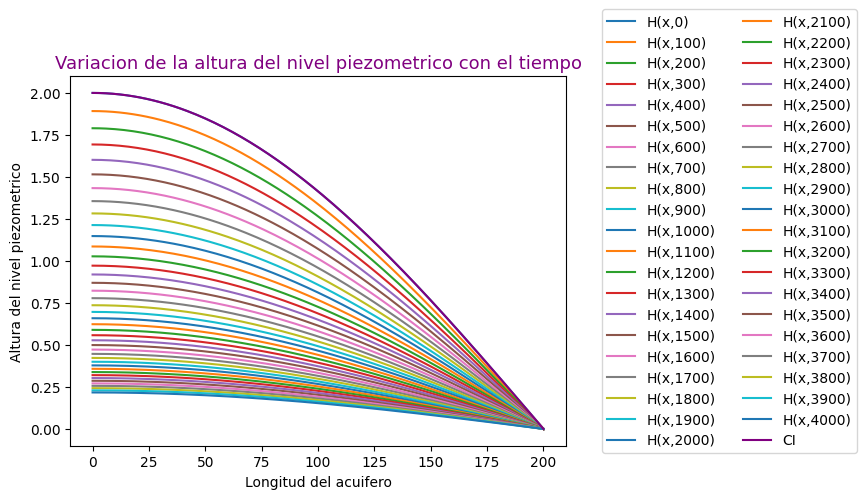

In [15]:
%matplotlib inline
x_analit=np.arange(L1+1)
for t in range(0,tiempo+100,100):
    y=solucion_analitica2(x_analit,t)
    plt.plot(x_analit,y,label=f"H(x,{t})")

plt.title("Variacion de la altura del nivel piezometrico con el tiempo",
          fontdict={"color":"purple","fontsize":"13"})
plt.plot(x_analit,hI*np.cos(np.pi*x_analit/(2*L1)),label="CI",color="purple")
plt.xlabel("Longitud del acuifero")
plt.ylabel("Altura del nivel piezometrico")
plt.legend( bbox_to_anchor=(1.6,1.2),ncol=2)
plt.show()

realicemos la simulación

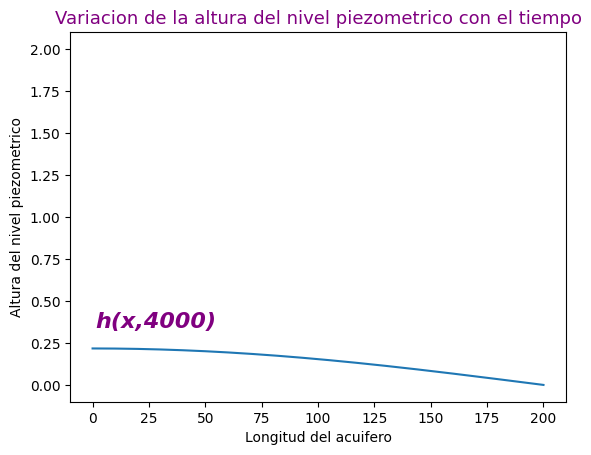

In [33]:
#para correrlo local     %matplotlib notebook  abajo descomentar

#%matplotlib notebook 
fig, ax=plt.subplots()
container = []
ht=10
plt.title("Variacion de la altura del nivel piezometrico con el tiempo"
          ,fontdict={"color":"purple","fontsize":"13"})
plt.xlabel("Longitud del acuifero")
plt.ylabel("Altura del nivel piezometrico")
for i in range(0,tiempo+ht,ht):
    line, = ax.plot(solucion_analitica2(x_analit,i), animated=True,label="jaja")
    
    
    
    title = ax.text(0.05,0.2,f"h(x,{i})",
                    transform=ax.transAxes, fontdict={'size': 16,
                        "color":"purple","fontweight":"bold"
                        ,"fontstyle":'italic'})
    
    container.append([line,title])

animacion_analitica1 = animation.ArtistAnimation(fig, container, interval=10, blit=True)


HTML(animacion_analitica1.to_jshtml())




## Metodo de diferencias finitas
Recordemos la ecuacion:

## <center>$\frac{\partial h}{\partial t}=\alpha^2\frac{\partial^{2} h}{\partial x^{2}}$ 
    
con las siguientes condiciones:   
<center>$h(x,0)=f(x)$   
<center>$h_{x}(0,t)=h(L,t)=0$
    
la discretizacion de segundo orden en el espacio y primer orden en el tiempo esta dada por:    
    
    
## <center>$\frac{h^{n+1}_i-h^{n}_i}{dt}=\alpha^2
\frac{h^{n}_{i}-2h^{n}_{i}+h^{n}_{i+1}}{dx}$
    
donde $dt$ y $dx$ son los pasos en el tiempo y x respectivamente.  
despejando se tiene:
    
### <center>$h^{n+1}_{i}=(1-2r)h^{n}_{i}+r(h^{n}_{i-1}+h^{n}_{i+1})$

de las condiciones de contorno se tiene que:
    
### <center>$h^{n}_{i=0}=h^{n}_{i=1}$ 
### <center>$h^{n}_{i=L}=0$
    
y de la condición inicial: 

### <center>$h^{0}_{i}=f(i)$

    
con 
    
###   <center>$r=\frac{\alpha^2dt}{dx}$   
### <center>$\alpha=\sqrt{\frac{T}{S}}$    

Para que sea estable la solución se debe cumplir la siguiente condición:
<center>$0\leq r \leq\frac{1}{2}$
    
por tanto la relacion entre los pasos debe cumplir:
    
### <center>$dt \leq\frac{dx^2}{2\alpha^2}$

Ahora implementemos la solucion en diferencias:

In [27]:
#recuerde colocar los mismo valores 
#para comparar con la solución analitica
L1=200
m1=1
pi1=np.pi
T=900
S=100
alfa1=math.sqrt(T/S)

dx=5
dt=1
estabilidad=(dt<=(dx**2/(2*alfa1**2)))
tiempo=4000
r=alfa1**2*dt/dx**2

print("La solución es estable:", estabilidad)

x_DF=np.arange(0,L1+dx,dx) #particion de la longitud del acuifero
N=len(x_DF)

#condicion inicial

hI=2

h_CI=hI*np.cos(x_DF*np.pi/(2*L1))

h1=np.zeros(N)
#condciones de contorno

h1[0]=h1[1]=0
h1[len(x_DF)-1]=0


La solución es estable: True


In [18]:
h0=hI*np.cos(x_DF*np.pi/(2*L1))
h1=np.zeros(N)

solucion_diferencias_finitas2=[h0]
t=dt
while t<=tiempo:

    h1=(1-2*r)*h0+r*(np.roll(h0,1)+np.roll(h0,-1))
    
    h1[0]=h1[1]
    h1[len(x_DF)-1]=0
    solucion_diferencias_finitas2.append(h1)
    h0=h1
    t+=dt

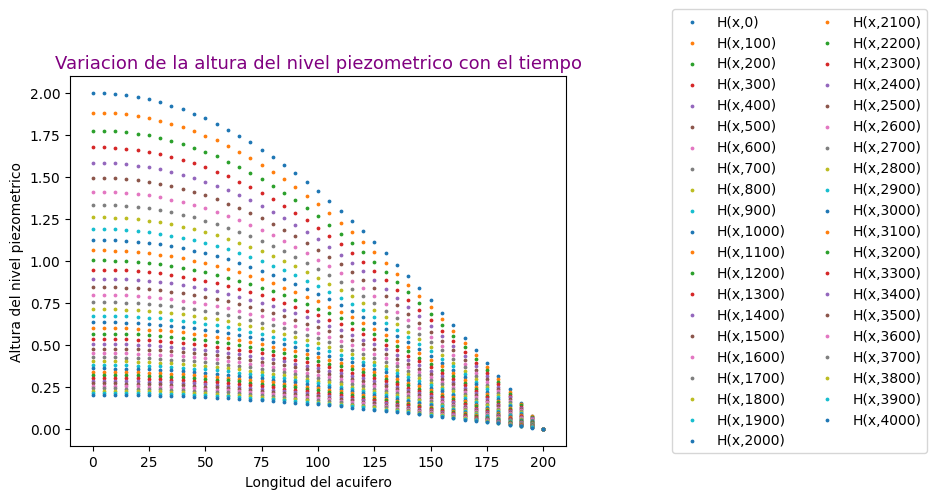

In [19]:
%matplotlib inline
ht=100
for t in range(0,tiempo+1,ht):
    
    plt.scatter(x_DF,solucion_diferencias_finitas2[t],label=f"H(x,{t})",s=3)

plt.title("Variacion de la altura del nivel piezometrico con el tiempo",fontdict={"color":"purple","fontsize":"13"})

plt.xlabel("Longitud del acuifero")
plt.ylabel("Altura del nivel piezometrico")
plt.legend( bbox_to_anchor=(1.2,1.2),ncol=2)
plt.show()

simulación de la solución en diferencias finitas:

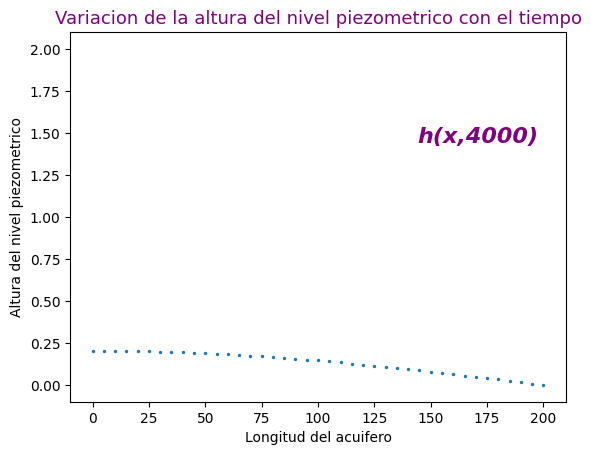

In [35]:
#para correrlo local     %matplotlib notebook  abajo descomentar
#%matplotlib notebook 

fig, ax=plt.subplots()
container = []
ht=10
plt.title("Variacion de la altura del nivel piezometrico con el tiempo"
          ,fontdict={"color":"purple","fontsize":"13"})
plt.xlabel("Longitud del acuifero")
plt.ylabel("Altura del nivel piezometrico")
for i in range(0,tiempo+ht,ht):
    scat = ax.scatter(x_DF,solucion_diferencias_finitas2[i],
                      s=2 ,animated=True)
    
    title = ax.text(0.7,0.7,f"h(x,{i})",
                   transform=ax.transAxes,fontdict={'size': 16,
                        "color":"purple","fontweight":"bold"
                        ,"fontstyle":'italic'} )
    
    container.append([scat,title])

animacion_dif_finitas2 = animation.ArtistAnimation(fig, container, interval=20, blit=True)



HTML(animacion_dif_finitas2.to_jshtml())



### Comparación de las soluciones  
Grafico de la superposición de las soluciones


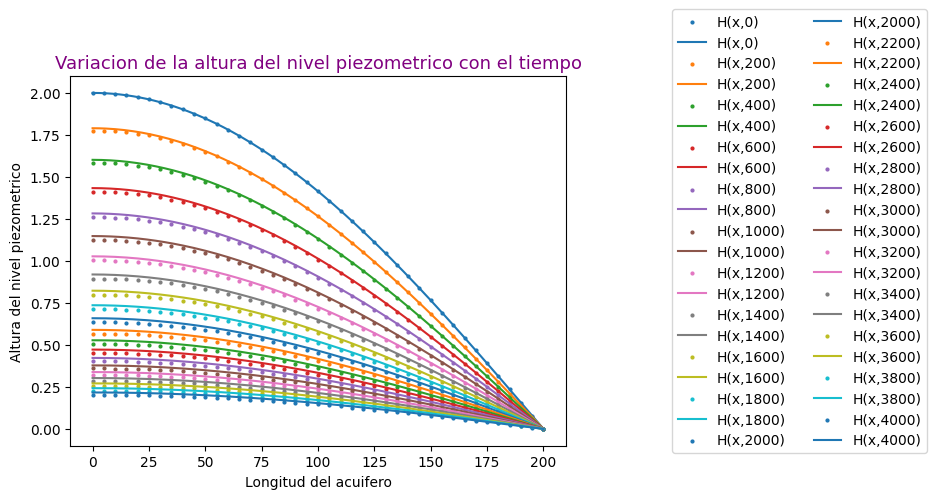

In [21]:
%matplotlib inline
xt=np.arange(L1+1)
ht=200

for t in range(0,tiempo+1,ht):
    y=solucion_analitica2(x_analit,t)
    plt.scatter(x_DF,solucion_diferencias_finitas2[t],
                label=f"H(x,{t})",s=4)
    plt.plot(xt,y,label=f"H(x,{t})")

    plt.title("Variacion de la altura del nivel piezometrico con el tiempo",
              fontdict={"color":"purple","fontsize":"13"})
#plt.plot(x_analit,hI*np.cos(x_analit*np.pi/(2*L1)),label="CI",color="purple")
plt.xlabel("Longitud del acuifero")
plt.ylabel("Altura del nivel piezometrico")
plt.legend( bbox_to_anchor=(1.2,1.2),ncol=2)
plt.show()

Simulación de las superposición de las soluciones 

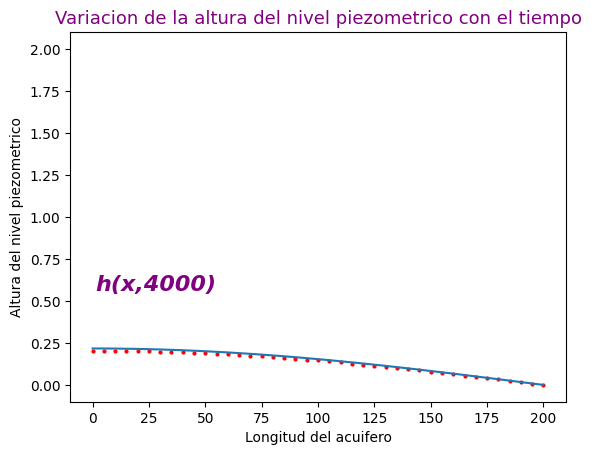

In [30]:
#para correrlo local     %matplotlib notebook  abajo descomentar
#%matplotlib notebook 

fig, ax=plt.subplots()
container = []
ht=10
plt.title("Variacion de la altura del nivel piezometrico con el tiempo"
          ,fontdict={"color":"purple","fontsize":"13"})
plt.xlabel("Longitud del acuifero")
plt.ylabel("Altura del nivel piezometrico")
for i in range(0,tiempo+ht,ht):
    line, = ax.plot(solucion_analitica2(x_analit,i), animated=True,label="jaja")
    
    scat = ax.scatter(x_DF,solucion_diferencias_finitas2[i],s=4 ,color="red",animated=True)
    
    title = ax.text(0.05,0.3,f"h(x,{i})",
                    transform=ax.transAxes,fontdict={'size': 16,
                        "color":"purple","fontweight":"bold"
                        ,"fontstyle":'italic'} )
    
    container.append([line,title,scat])

animacion_superposicion_2= animation.ArtistAnimation(fig, container, interval=10, blit=True)

HTML(animacion_superposicion_2.to_jshtml())

#codigo abajo para guardar la animación como un gif


#IMWriter = animation.ImageMagickWriter(fps=30)

#animacion_superposicion_2 .save("diferencias_finitas.gif", writer=IMWriter)







In [1]:
"bien"

'bien'